<a href="https://colab.research.google.com/github/WesselJonge/DLforSegregation/blob/main/Full_Image_measuring_CascadeMaskRcnn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install

In [ ]:
!pip install -U torch torchvision -f https://download.pytorch.org/whl/cu101/torch_stable.html
!pip install cython pyyaml==5.4.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

import sys, os, distutils.core
!git clone 'https://github.com/WesselJonge/detectron2.git'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog
from IPython import display

# for the data processing
from torch import tensor
from collections import Counter
from matplotlib import pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import math
import pandas as pd
!pip install feret
import feret #https://pypi.org/project/feret/
display.clear_output()

In [ ]:
Totimg = cv2.imread("/content/drive/MyDrive/Thesis/IMG_4923.JPG")
Height, width = Totimg.shape[:2]
Ph=512
Pw=512
Hf = round(Height/Ph)
Wf = round(width/Pw)
sliced = np.split(Totimg,Hf,axis=0)
Sections =  [np.split(img_slice,Wf,axis=1) for img_slice in sliced]

In [ ]:
print(Height/Hf)
print(width/Wf)

504.0
504.0


In [ ]:
!curl -L "https://app.roboflow.com/ds/2VrRfZkyNF?key=CfuAVZ7W2l" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")
display.clear_output()

# Model

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("Misc/cascade_mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 0
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 5
cfg.SOLVER.MAX_ITER = 40000

cfg.SOLVER.STEPS = (1, 1000)
cfg.SOLVER.GAMMA = 0.05


cfg.MODEL.DEVICE = "cpu" # remove for GPU operations

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500
cfg.TEST.DETECTIONS_PER_IMAGE = 300


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
!unzip /content/drive/MyDrive/Thesis/TrainedModels/cascnew38.zip -d output
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
#trainer.train()
display.clear_output()

# Processing

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set a testing threshold
cfg.TEST.DETECTIONS_PER_IMAGE = 300
predictor = DefaultPredictor(cfg)
from detectron2.utils.visualizer import ColorMode

Output_Coke=[]
Output_Sinter=[]
Output_Pellet=[]
Output_Num_Par = []
Output_Num_Size = []
Output_feret_Coke = []
Output_feret_Sinter = []
Output_feret_Pellet = []
Output_Area_Coke = []
Output_Area_Sinter = []
Output_Area_Pellet = []
Pred=[]
Output_Tiny_F=[]
Output_Mid_F=[]
Output_Big_F=[]
Output_Tiny_AE=[]
Output_Mid_AE=[]
Output_Big_AE=[]
for H in range(0,Hf):
  for W in range(0,Wf):
    im=Sections[H][W]
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                my_dataset_train_metadata,
                scale=1,
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    Pred.append(out.get_image()[:, :, ::-1][..., ::-1])

    # make classes readable
    instances=[]
    for i in range(0,outputs["instances"].pred_classes.size()[0]):
      instances.append(outputs["instances"].pred_classes[i].item())

    #Devided them in 3 classes
    Sample1=[]
    Sample2=[]
    Sample3=[]
    Coke=[]
    Pellet=[]
    Sinter=[]
    Feret_Coke=[]
    Area_Coke=[]
    Feret_Sinter=[]
    Area_Sinter=[]
    Feret_Pellet=[]
    Area_Pellet=[]
    Tiny_F=[]
    Mid_F=[]
    Big_F=[]
    Tiny_AE=[]
    Mid_AE=[]
    Big_AE=[]
    Size_counter=[0,0,0,0,0,0]

    # Filter tensors numbers for different classes
    for i in range(0,outputs["instances"].pred_classes.size()[0]):
      if outputs["instances"].pred_classes[i].item() == 1:
        Sample1.append(i)
        if len(Coke)==0:
          Coke=outputs["instances"].pred_masks[i].cpu()
        if len(Coke)!=0:
          Coke= Coke + outputs["instances"].pred_masks[i].cpu()
        Feret_Coke.append([feret.max(outputs["instances"].pred_masks[i].cpu().numpy()),feret.max90(outputs["instances"].pred_masks[i].cpu().numpy())])
        Area_Coke.append(sum(sum(outputs["instances"].pred_masks[i].cpu())))
      if outputs["instances"].pred_classes[i].item() == 2:
        Sample2.append(i)
        if len(Pellet)==0:
          Pellet=outputs["instances"].pred_masks[i].cpu()
        if len(Pellet)!=0:
          Pellet= Pellet + outputs["instances"].pred_masks[i].cpu()
        Feret_Pellet.append([feret.max(outputs["instances"].pred_masks[i].cpu().numpy()),feret.max90(outputs["instances"].pred_masks[i].cpu().numpy())])
        Area_Pellet.append(sum(sum(outputs["instances"].pred_masks[i].cpu())))
      if outputs["instances"].pred_classes[i].item() == 3:
        Sample3.append(i)
        if len(Sinter)==0:
          Sinter=outputs["instances"].pred_masks[i].cpu()
        if len(Sinter)!=0:
          Sinter= Sinter + outputs["instances"].pred_masks[i].cpu()
        Feret_Sinter.append([feret.max(outputs["instances"].pred_masks[i].cpu().numpy()),feret.max90(outputs["instances"].pred_masks[i].cpu().numpy())])
        Area_Sinter.append(sum(sum(outputs["instances"].pred_masks[i].cpu())))

      # Look for the sizes of the particles and classify them in 3 size groups
      if feret.max(outputs["instances"].pred_masks[i].cpu().numpy())<=50:
        Size_counter[0]=Size_counter[0]+1
        if len(Tiny_F)==0:
          Tiny_F=outputs["instances"].pred_masks[i].cpu()
        if len(Tiny_F)!=0:
          Tiny_F= Tiny_F + outputs["instances"].pred_masks[i].cpu()

      if feret.max(outputs["instances"].pred_masks[i].cpu().numpy())>=50:
        if feret.max(outputs["instances"].pred_masks[i].cpu().numpy())<=100:
          Size_counter[1]=Size_counter[1]+1
          if len(Mid_F)==0:
            Mid_F=outputs["instances"].pred_masks[i].cpu()
          if len(Mid_F)!=0:
            Mid_F= Mid_F + outputs["instances"].pred_masks[i].cpu()

        if feret.max(outputs["instances"].pred_masks[i].cpu().numpy())>=100:
          Size_counter[2]=Size_counter[2]+1
          if len(Big_F)==0:
            Big_F=outputs["instances"].pred_masks[i].cpu()
          if len(Big_F)!=0:
            Big_F= Big_F + outputs["instances"].pred_masks[i].cpu()

      if 2*math.sqrt(sum(sum(outputs["instances"].pred_masks[i].cpu()))/math.pi)<=50:
        Size_counter[3]=Size_counter[3]+1
        if len(Tiny_AE)==0:
          Tiny_AE=outputs["instances"].pred_masks[i].cpu()
        if len(Tiny_AE)!=0:
          Tiny_AE= Tiny_AE + outputs["instances"].pred_masks[i].cpu()

      if 2*math.sqrt(sum(sum(outputs["instances"].pred_masks[i].cpu()))/math.pi)>=50:
        if 2*math.sqrt(sum(sum(outputs["instances"].pred_masks[i].cpu()))/math.pi)<=100:
          Size_counter[4]=Size_counter[4]+1
          if len(Mid_AE)==0:
            Mid_AE=outputs["instances"].pred_masks[i].cpu()
          if len(Mid_AE)!=0:
            Mid_AE= Mid_AE + outputs["instances"].pred_masks[i].cpu()

        if 2*math.sqrt(sum(sum(outputs["instances"].pred_masks[i].cpu()))/math.pi)>=100:
          Size_counter[5]=Size_counter[5]+1
          if len(Big_AE)==0:
            Big_AE=outputs["instances"].pred_masks[i].cpu()
          if len(Big_AE)!=0:
            Big_AE= Big_AE + outputs["instances"].pred_masks[i].cpu()

    # All outputs of the post processing
    Number_Particles = Counter(instances)
    print(H,W, Number_Particles)
    Output_Coke.append(Coke)
    Output_Sinter.append(Sinter)
    Output_Pellet.append(Pellet)
    Output_Tiny_F.append(Tiny_F)
    Output_Mid_F.append(Mid_F)
    Output_Big_F.append(Big_F)
    Output_Tiny_AE.append(Tiny_AE)
    Output_Mid_AE.append(Mid_AE)
    Output_Big_AE.append(Big_AE)
    Output_Num_Par.append(Number_Particles)
    Output_Num_Size.append(Size_counter)
    Output_feret_Coke.append(Feret_Coke)
    Output_Area_Coke.append(Area_Coke)
    Output_feret_Sinter.append(Feret_Sinter)
    Output_Area_Sinter.append(Area_Sinter)
    Output_feret_Pellet.append(Feret_Pellet)
    Output_Area_Pellet.append(Area_Pellet)

[05/12 14:54:40 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


0 0 Counter()
0 1 Counter()
0 2 Counter()
0 3 Counter()
0 4 Counter()
0 5 Counter()
1 0 Counter()
1 1 Counter({1: 3})
1 2 Counter({1: 3})
1 3 Counter()
1 4 Counter()
1 5 Counter()
2 0 Counter({1: 7, 2: 1})
2 1 Counter({1: 18, 2: 7, 3: 4})
2 2 Counter({1: 19, 3: 7, 2: 7})
2 3 Counter({1: 12, 3: 11, 2: 4})
2 4 Counter({1: 1})
2 5 Counter()
3 0 Counter({1: 17, 3: 11, 2: 4})
3 1 Counter({3: 31, 2: 20, 1: 13})
3 2 Counter({3: 57, 2: 30, 1: 8})
3 3 Counter({3: 44, 2: 22, 1: 12})
3 4 Counter({1: 9, 2: 5, 3: 2})
3 5 Counter()
4 0 Counter({1: 12, 3: 11, 2: 10})
4 1 Counter({3: 42, 2: 32, 1: 4})
4 2 Counter({3: 51, 2: 35, 1: 3})
4 3 Counter({3: 37, 2: 17, 1: 12})
4 4 Counter({1: 9, 3: 6, 2: 5})
4 5 Counter()
5 0 Counter({1: 7, 3: 4, 2: 2})
5 1 Counter({3: 19, 2: 13, 1: 12})
5 2 Counter({3: 24, 2: 13, 1: 11})
5 3 Counter({3: 20, 2: 14, 1: 12})
5 4 Counter({1: 6, 3: 2, 2: 1})
5 5 Counter()
6 0 Counter()
6 1 Counter({1: 4, 3: 1})
6 2 Counter({1: 7, 2: 2, 3: 1})
6 3 Counter({1: 3, 3: 2, 2: 2})
6 4 C

In [ ]:
# counting the particles
Num_par= []
aco=0
asi=0
ape=0
Total_num_par=0
for j in range(0,Hf):
  for k in range(0,Wf):
    Num_par.append([Output_Num_Par[j*Wf+k][1],Output_Num_Par[j*Wf+k][2],Output_Num_Par[j*Wf+k][3]])
    Total_num_par=Total_num_par+Output_Num_Par[j*Wf+k][1]+Output_Num_Par[j*Wf+k][2]+Output_Num_Par[j*Wf+k][3]
    aco=aco+Output_Num_Par[j*Wf+k][1]
    asi=asi+Output_Num_Par[j*Wf+k][2]
    ape=ape+Output_Num_Par[j*Wf+k][3]
print(Num_par)
print(Total_num_par)
print(aco)
print(asi)
print(ape)

[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [3, 0, 0], [3, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [7, 1, 0], [18, 7, 4], [19, 7, 7], [12, 4, 11], [1, 0, 0], [0, 0, 0], [17, 4, 11], [13, 20, 31], [8, 30, 57], [12, 22, 44], [9, 5, 2], [0, 0, 0], [12, 10, 11], [4, 32, 42], [3, 35, 51], [12, 17, 37], [9, 5, 6], [0, 0, 0], [7, 2, 4], [12, 13, 19], [11, 13, 24], [12, 14, 20], [6, 1, 2], [0, 0, 0], [0, 0, 0], [4, 0, 1], [7, 2, 1], [3, 2, 2], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0]]
857
224
246
387


In [ ]:
# getting the ratios of particles
Pixels = 504*504
Tot_ratios = []
for i in range(0,Wf*Hf):
  c=sum(Output_Coke[i])
  s=sum(Output_Sinter[i])
  p=sum(Output_Pellet[i])
  if type(c)!=int:
    c=sum(c)
  if type(s)!=int:
    s=sum(s)
  if type(p)!=int:
    p=sum(p)
  R_c=0
  R_s=0
  R_p=0
  R_v=0
  if c!=0:
    R_c = round(float(c/Pixels),4)
  if s!=0:
    R_s = round(float(s/Pixels),4)
  if p!=0:
    R_p = round(float(p/Pixels),4)
  if (c+s+p)!=0:
    R_v = round(1-float((c+s+p)/Pixels),4)
  R=[R_c , R_s , R_p , R_v]
  Tot_ratios.append(R)


In [ ]:
# Segregation index
M=0
C_avg_coke=[]
C_avg_sinter=[]
C_avg_pellet=[]
I=[]
dif_C=[]
dif_S=[]
dif_P=[]

for i in range(0,len(Num_par)):
  if sum(Num_par[i])!=0:
    M=M+1
    if Num_par[i][0]!=0:
      C_avg_coke.append(Tot_ratios[i][0])
    if Num_par[i][1]!=0:
      C_avg_sinter.append(Tot_ratios[i][1])
    if Num_par[i][2]!=0:
      C_avg_pellet.append(Tot_ratios[i][2])

C_avg=sum(C_avg_coke)/M , sum(C_avg_sinter)/M , sum(C_avg_pellet)/M

for i in range(0,len(C_avg_coke)):
  dif_C.append((C_avg_coke[i]-C_avg[0])**2)
for i in range(0,len(C_avg_sinter)):
  dif_S.append((C_avg_sinter[i]-C_avg[1])**2)
for i in range(0,len(C_avg_pellet)):
  dif_P.append((C_avg_pellet[i]-C_avg[2])**2)
I.append(math.sqrt(sum(dif_C)/(M-1)))
I.append(math.sqrt(sum(dif_S)/(M-1)))
I.append(math.sqrt(sum(dif_P)/(M-1)))

print(I)


[0.21586196028944057, 0.1477633332822005, 0.07209595784323372]


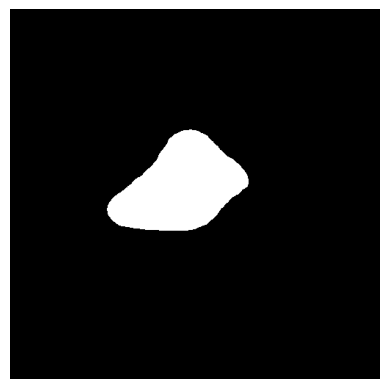

In [ ]:
# shows a singluar particle
im=Sections[3][2]
outputs = predictor(im)
for i in range(0,outputs["instances"].pred_classes.size()[0]):
  if outputs["instances"].pred_classes[i].item() == 1:
    Sample1.append(i)

plt.axis('off')
plt.imshow(outputs["instances"].pred_masks[Sample1[0]].cpu(),cmap='gray')

# Images, the slow part

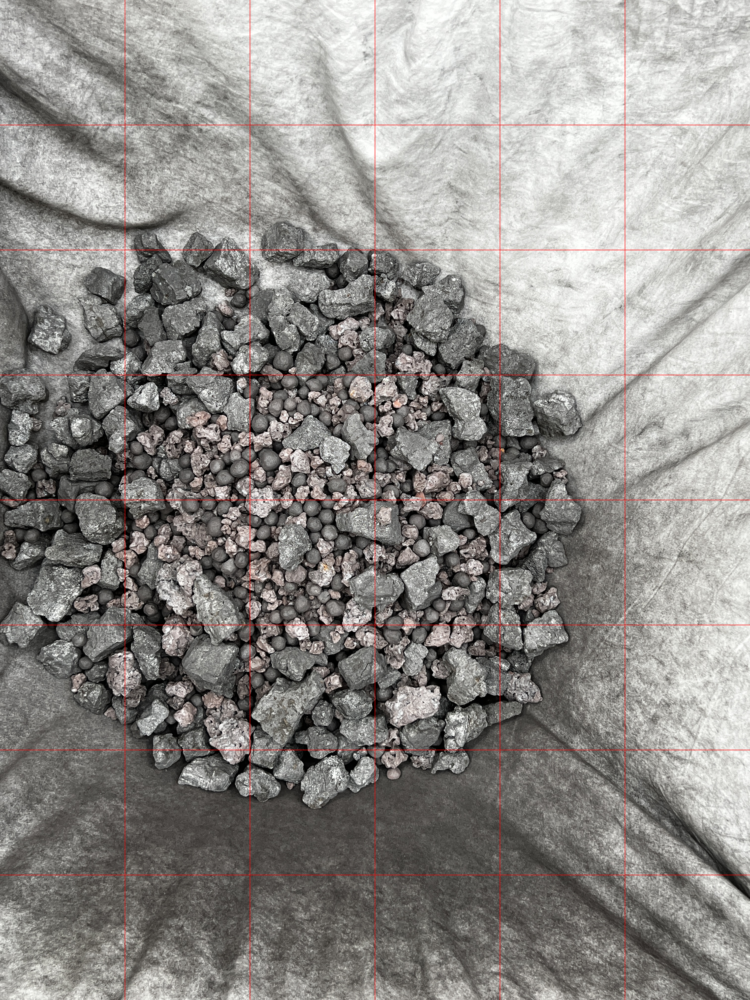

In [ ]:
# Draws the sectionlines on the image

Ph=504
Pw=504

for i in range(0,len(Totimg)):
  for j in range(0,len(Totimg[0])):
    if i==Ph or i==Ph*2 or i==Ph*3 or i==Ph*4 or i==Ph*5 or i==Ph*6 or i==Ph*7 or i==Ph*8 or i==Ph*9:
      Totimg[i][j]=[0,0,255]
      Totimg[i-1][j]=[0,0,255]
    if j==Pw or j==Pw*2 or j==Pw*3 or j==Pw*4 or j==Pw*5 or j==Pw*6 or j==Pw*7 or j==Pw*8 or j==Pw*9:
      Totimg[i][j]=[0,0,255]
      Totimg[i][j-1]=[0,0,255]
cv2_imshow(Totimg)

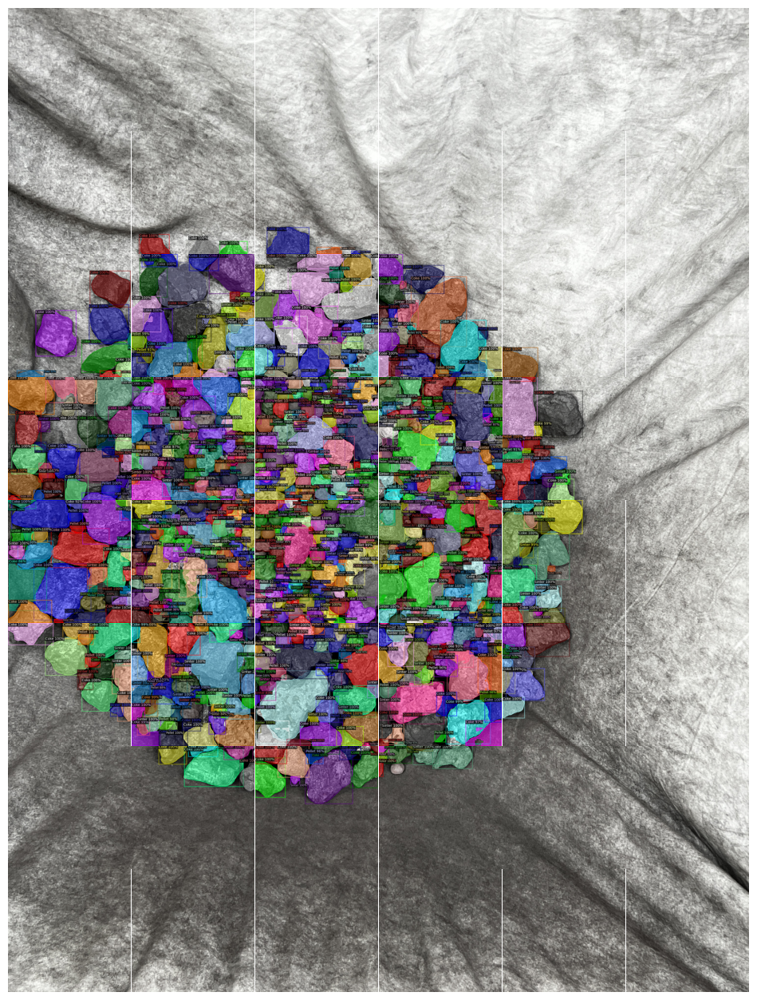

In [ ]:
# The predictions of the entire image
fig = plt.figure(figsize=(2*Wf, 2*Hf))
columns = Wf
rows = Hf
for i in range(0,len(Pred)):
 fig.add_subplot(rows, columns, i+1)
 plt.axis('off')
 plt.imshow(Pred[i])
fig.subplots_adjust(wspace=0, hspace=0)
plt.show()

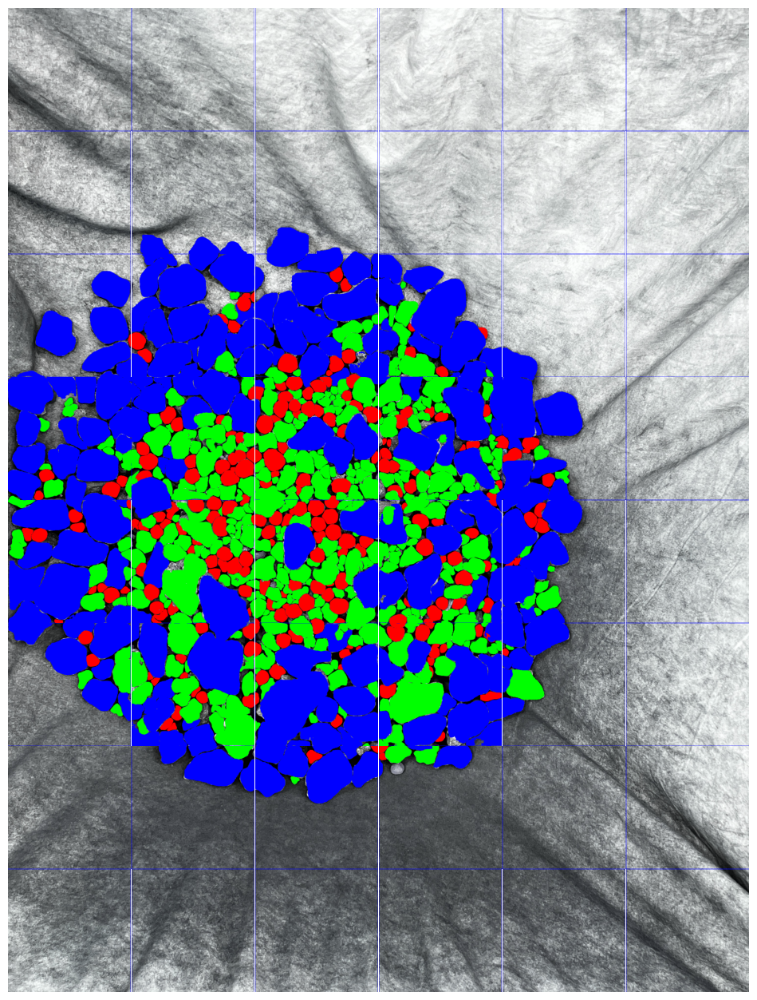

In [ ]:
# Colours the particles according to the material

Marked=Sections

for H in range(0,Hf):
 for W in range(0,Wf):
   if len(Output_Pellet[H*Wf+W])!=0:
     for i in range(0,Ph):
       for j in range(0,Pw):
         if Output_Pellet[H*Wf+W][i][j] == True:
           Marked[H][W][i][j]=[255,0,0]
   if len(Output_Sinter[H*Wf+W])!=0:
     for i in range(0,Ph):
       for j in range(0,Pw):
         if Output_Sinter[H*Wf+W][i][j] == True:
           Marked[H][W][i][j]=[0,255,0]
   if len(Output_Coke[H*Wf+W])!=0:
     for i in range(0,Ph):
       for j in range(0,Pw):
         if Output_Coke[H*Wf+W][i][j] == True:
           Marked[H][W][i][j]=[0,0,255]

fig = plt.figure(figsize=(2*Wf, 2*Hf))
columns = Wf
rows = Hf
for H in range(0,Hf):
 for W in range(0,Wf):
   fig.add_subplot(rows, columns, H*Wf+W+1)
   plt.axis('off')
   plt.imshow(Marked[H][W],aspect='equal')
fig.subplots_adjust(wspace=0, hspace=0)
plt.show()



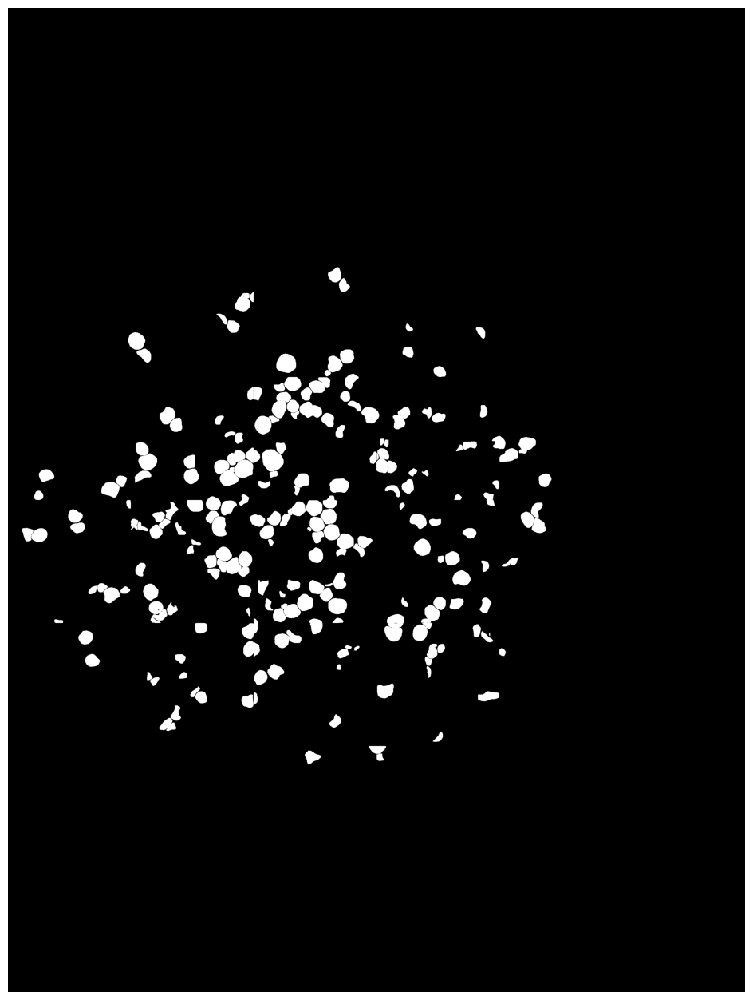

In [ ]:
# Binary view of all pellet particles
Zeros_masks=np.zeros((504,504))
Ph=504
Pw=504
image_Pellet=[]
for H in range(0,Hf):
  row=[]
  for W in range(0,Wf):
    if len(Output_Pellet[H*Wf+W])!=0:
      row.append(Output_Pellet[H*Wf+W])
    else:
      row.append(Zeros_masks)
  image_Pellet.append(row)

mask_binary=[]
for H in range(0,Hf):
  mask_binary.append(np.concatenate(image_Pellet[H],axis=1))

plt.figure(figsize=(2*Wf, 2*Hf))
plt.axis('off')
Testimage=np.concatenate(mask_binary)
plt.imshow(np.concatenate(mask_binary),cmap='gray')

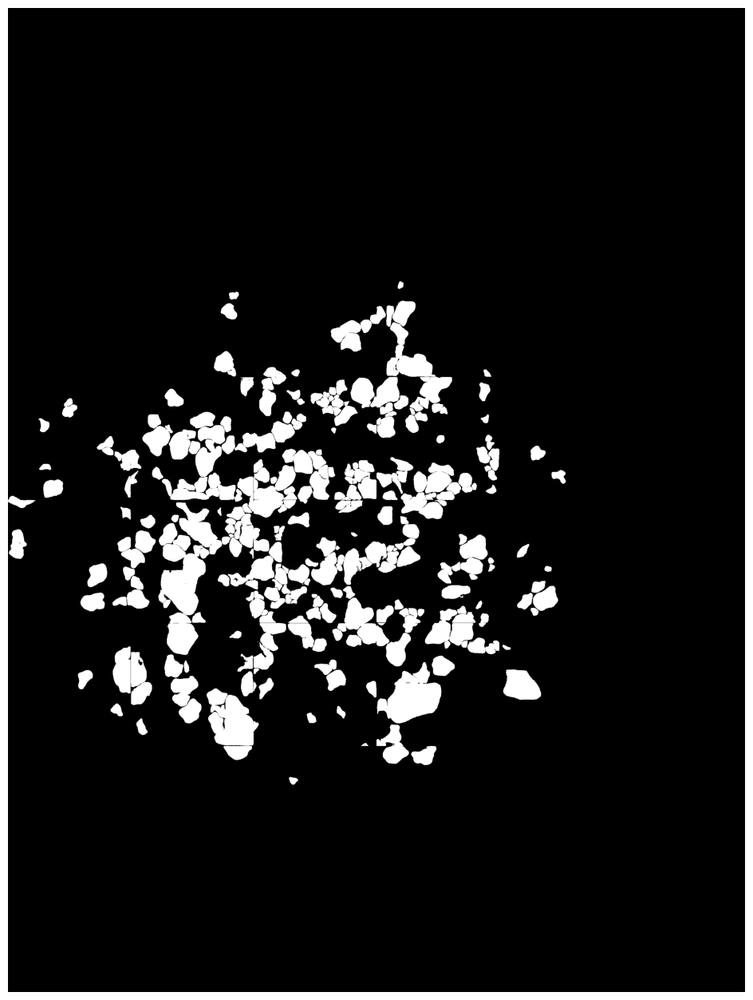

In [ ]:
# Binary view of all sinter particles
Zeros_masks=np.zeros((504,504))
Ph=504
Pw=504
image_Sinter=[]
for H in range(0,Hf):
  row=[]
  for W in range(0,Wf):
    if len(Output_Sinter[H*Wf+W])!=0:
      row.append(Output_Sinter[H*Wf+W])
    else:
      row.append(Zeros_masks)
  image_Sinter.append(row)

mask_binary=[]
for H in range(0,Hf):
  mask_binary.append(np.concatenate(image_Sinter[H],axis=1))

plt.figure(figsize=(2*Wf, 2*Hf))
plt.axis('off')
plt.imshow(np.concatenate(mask_binary),cmap='gray')

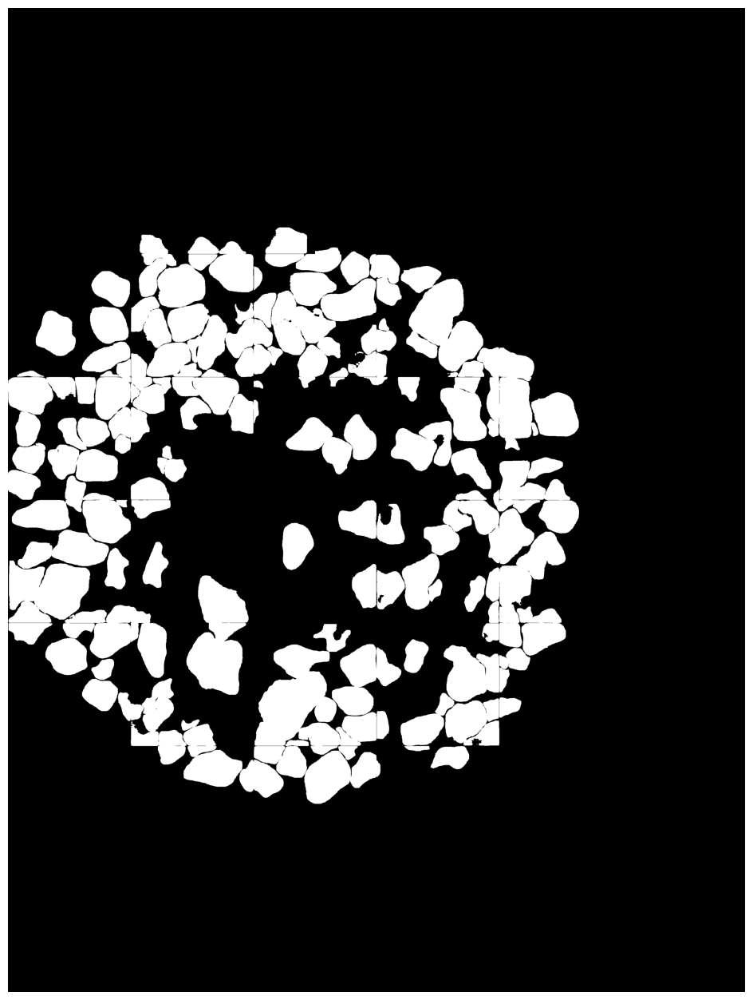

In [ ]:
# Binary view of all coke particles
Zeros_masks=np.zeros((504,504))
Ph=504
Pw=504
image_Coke=[]
for H in range(0,Hf):
  row=[]
  for W in range(0,Wf):
    if len(Output_Coke[H*Wf+W])!=0:
      row.append(Output_Coke[H*Wf+W])
    else:
      row.append(Zeros_masks)
  image_Coke.append(row)

mask_binary=[]
for H in range(0,Hf):
  mask_binary.append(np.concatenate(image_Coke[H],axis=1))

plt.figure(figsize=(2*Wf, 2*Hf))
plt.axis('off')
plt.imshow(np.concatenate(mask_binary),cmap='gray')

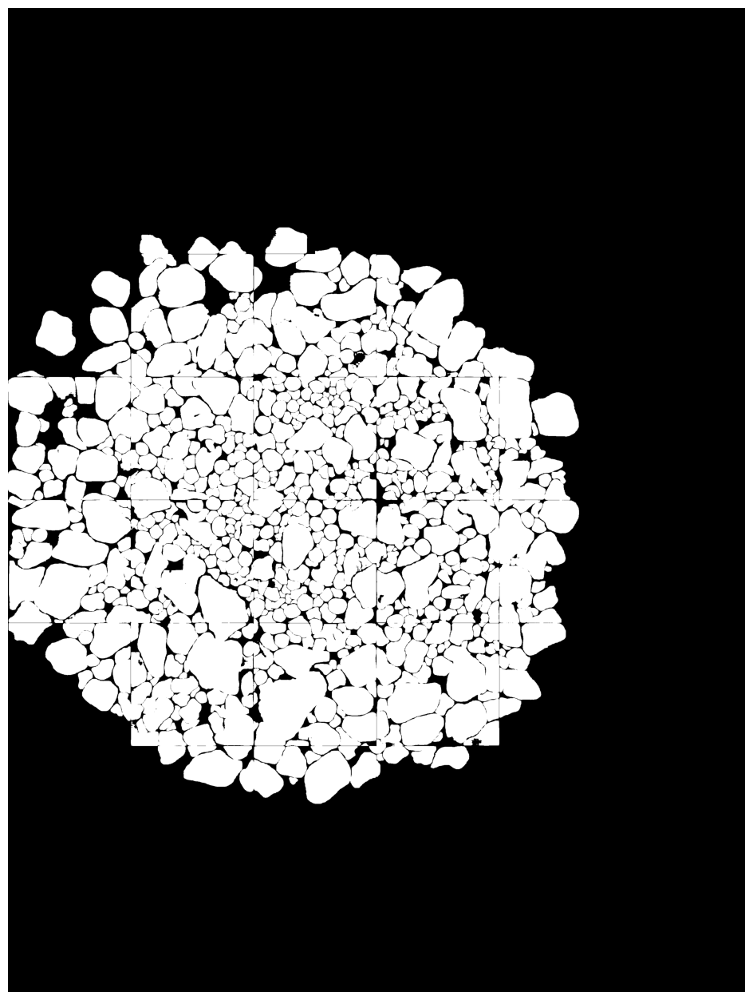

In [ ]:
# Binary view of all particles
Image_total_masks=[]
for H in range(0,Hf):
  row=[]
  for W in range(0,Wf):
    row.append(image_Coke[H][W]+image_Sinter[H][W]+image_Pellet[H][W])
  Image_total_masks.append(row)

mask_binary=[]
for H in range(0,Hf):
  mask_binary.append(np.concatenate(Image_total_masks[H],axis=1))

plt.figure(figsize=(2*Wf, 2*Hf))
plt.axis('off')
plt.imshow(np.concatenate(mask_binary),cmap='gray')

2 2 0 5
18.99758291244507
2 2 1 5
20.60948872566223
2 2 2 5
23.463707208633423
2 2 3 5
19.857399940490723
2 2 4 5
19.931500911712646
2 2 5 5
23.035199642181396
2 2 6 5
21.468870401382446
2 2 7 5
25.650968074798584
2 2 8 5
48.755584716796875
2 2 9 5
60.81259202957153
2 2 10 5
50.2351348400116
2 2 11 5
32.251264810562134
2 2 12 5
34.63243269920349
2 2 13 5
39.03865098953247
2 2 14 5
42.84997797012329
2 2 15 5
46.33521318435669
2 2 16 5
51.95006084442139
2 2 17 5
55.93916463851929
2 2 18 5
61.70246434211731
2 2 19 5
64.42225480079651
2 2 20 5
71.32085227966309
2 2 21 5
79.32962894439697
2 2 22 5
81.93585562705994


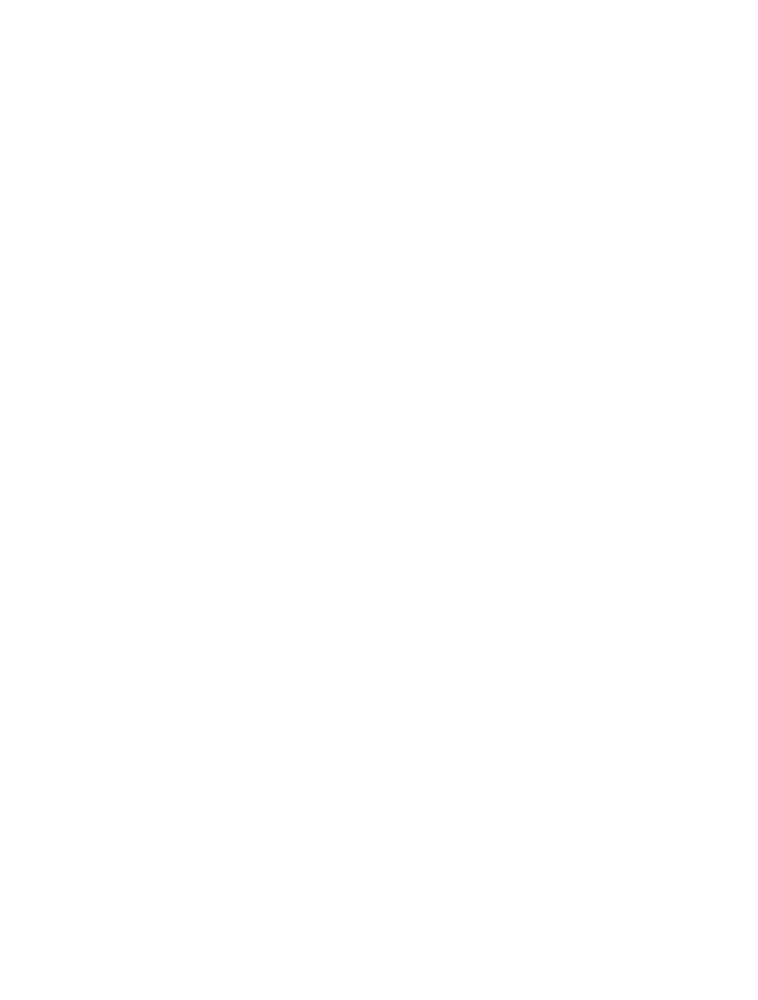

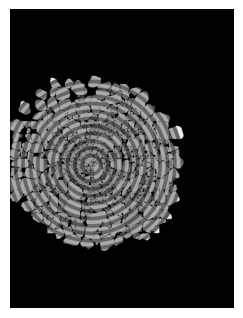

[[0.03879720645412492, 0.1430397634735479, 0.16163770740834738], [0.030982640793412692, 0.10647450265388975, 0.11730954648988227], [0.07129510808191752, 0.08820389022957514, 0.12490221431982695], [0.07008497465070164, 0.07775004377821522, 0.11888589680255549], [0.06540153004687776, 0.06954792235506402, 0.10921971644098087], [0.08654070334553078, 0.06650451345045738, 0.10533801970537865], [0.10178839576062924, 0.06573204956208974, 0.10884220453633707], [0.11303781425995132, 0.0732780684205361, 0.10344274581877608], [0.11992638896577576, 0.0719040653873348, 0.10400297184297912], [0.12288457472002283, 0.07574555560959222, 0.09962506213539832], [0.12586531300617418, 0.07915341532748194, 0.09686526592376257], [0.15467003934370363, 0.09251051207073882, 0.09959474004175162], [0.18116255580741022, 0.10787644669122551, 0.10296836266173388], [0.19328418692680296, 0.11533359715167264, 0.10473315010837785], [0.19834015990912157, 0.11541110459085527, 0.10567778406258098], [0.20302558991075326, 0.11

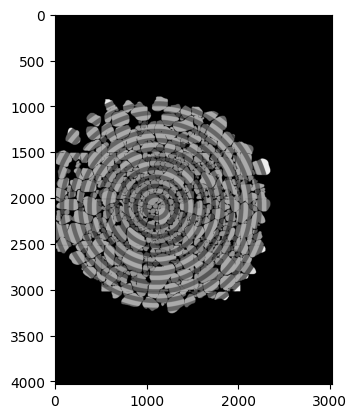

In [ ]:
# Measures segregation index for number of rings with a centre point on the image. The ring diameter increase could also be altered.

import time

Rings=24

Image_total_masks=[]
SI=[]
#SI=[[] for o in range(1)for p in range(1) for r in range(Rings)]

for H in range(0,Hf):
  row=[]
  for W in range(0,Wf):
    row.append(image_Coke[H][W]+2*image_Sinter[H][W]+3*image_Pellet[H][W])
  Image_total_masks.append(row)

mask_binary=[]
for H in range(0,Hf):
  mask_binary.append(np.concatenate(Image_total_masks[H],axis=1))
plt.figure(figsize=(2*Wf, 2*Hf))
plt.axis('off')
Loc_image=np.concatenate(mask_binary)

xlim=len(Loc_image)
ylim=len(Loc_image[0])

fig = plt.figure(figsize=(100, 20))

# Position
for o in range(2,3):#8
  for p in range(2,3):#8
    Origin=[1000+o*50,2000+p*50] # Center cords are [1100,2100]
# Rings
    for r in range(0,Rings-1):#Rings-1):
# Radius
      for k in range(5,6):#20):
        # Diameters=[50+10*k,10*k,10*k,10*k,10*k,10*k,10*k,10*k,10*k,10*k]
        t = time.time()
        Loc_image=np.concatenate(mask_binary)
        Diameters=[50+10*k]
        Diameters += (1+r)*[10*k]
        Boundaries=[]
        Outeredge=(sum(Diameters))**2
        for i in range(0,(3+r)):
          Boundaries.append((sum(Diameters[:i]))**2)
        print(o,p,r,k)
        cokesum=[0]*(2+r)
        sintersum=[0]*(2+r)
        pelletsum=[0]*(2+r)
        Pixels=[0]*(2+r)

        # Pixels in image
        for y in range(xlim):
          for x in range(ylim):

            # Check if in range of outer otherwise pass all checks
            if (x-Origin[0])*(x-Origin[0]) +(y-Origin[1])*(y-Origin[1]) > Outeredge:
              if Loc_image[y][x]==0:
                Loc_image[y][x]+=15
              continue

            # Check in which ring it falls
            for i in range(0,(2+r)):
              if (x-Origin[0])*(x-Origin[0]) +(y-Origin[1])*(y-Origin[1]) < Boundaries[i+1] and (x-Origin[0])*(x-Origin[0]) +(y-Origin[1])*(y-Origin[1]) >= Boundaries[i]:
                if Loc_image[y][x]==1:
                  cokesum[i]+=1
                elif Loc_image[y][x]==2:
                  sintersum[i]+=1
                elif Loc_image[y][x]==3:
                  pelletsum[i]+=1
                Pixels[i]+=1
                if (i % 2) ==0:
                  if Loc_image[y][x]==0:
                    Loc_image[y][x]+=15
                  else:
                    Loc_image[y][x]+=4
                else:
                  if Loc_image[y][x]==0:
                    Loc_image[y][x]+=15
                  else:
                    Loc_image[y][x]+=8

                break


        # Counts to concentration
        C_coke=np.divide(cokesum,Pixels)
        C_Sinter=np.divide(sintersum,Pixels)
        C_Pellet=np.divide(pelletsum,Pixels)
        # Average concentrations
        TCokeAvg = (sum(C_coke)) /(2+r)
        TSinterAvg = (sum(C_Sinter)) /(2+r)
        TPelletAvg = (sum(C_Pellet)) /(2+r)

        dif_TC=[]
        dif_TS=[]
        dif_TP=[]

        for i in range(0,(2+r)):
          dif_TC.append((C_coke[i]-TCokeAvg)*(C_coke[i]-TCokeAvg))
          dif_TS.append((C_Sinter[i]-TSinterAvg)*(C_Sinter[i]-TSinterAvg))
          dif_TP.append((C_Pellet[i]-TPelletAvg)*(C_Pellet[i]-TPelletAvg))

        SI.append([math.sqrt(sum(dif_TC)/((2+r)-1)),math.sqrt(sum(dif_TS)/((2+r)-1)),math.sqrt(sum(dif_TP)/((2+r)-1))])#SI[3*(4*o+p)+r]
        print(time.time()-t)
        fig.add_subplot(1, 29, k)
        plt.axis('off')
        plt.imshow(Loc_image,cmap='gray_r')
plt.show()

print(SI)
#plt.imshow(Loc_image,cmap='gray_r')


2 2 6 17
47.07484436035156
2 2 7 15
52.29997205734253
2 2 8 13
51.15704679489136
2 2 9 12
52.66610527038574
2 2 10 11
57.14798617362976
2 2 11 10
71.47267055511475
2 2 12 9
79.71187448501587
2 2 14 8
80.36349940299988
2 2 16 7
102.18263959884644
2 2 19 6
79.16981649398804
2 2 23 5
85.56200337409973
2 2 28 4
90.92950487136841
2 2 29 4
100.56216669082642
2 2 30 4
102.80259919166565
2 2 38 3
112.81266689300537
2 2 39 3
116.87106108665466


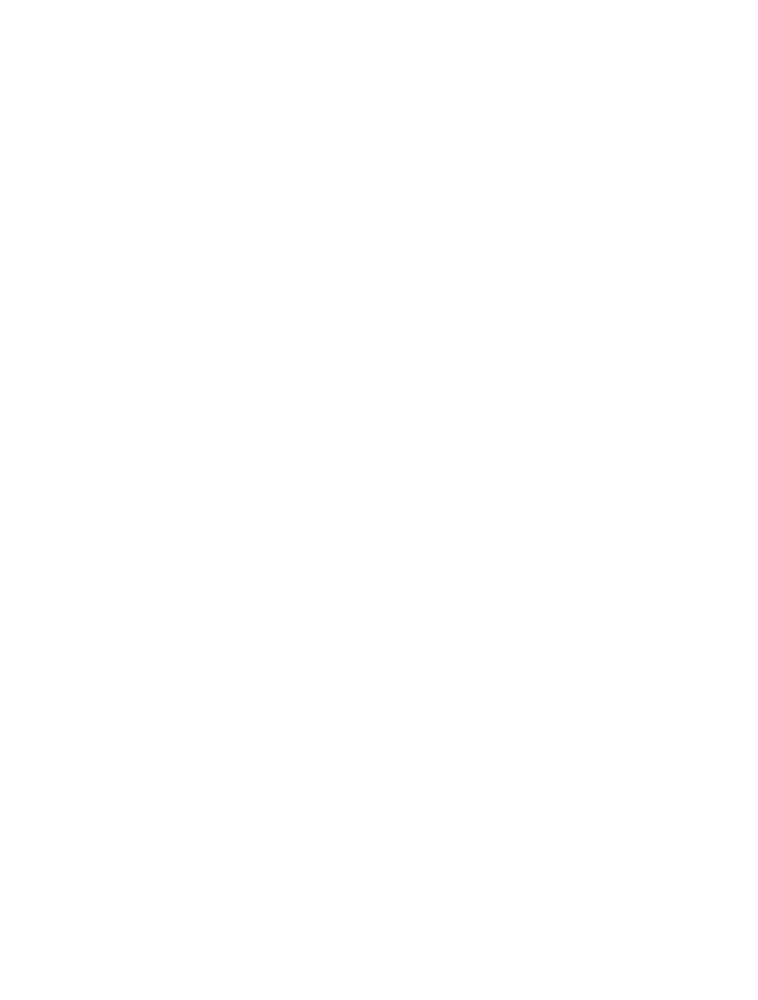

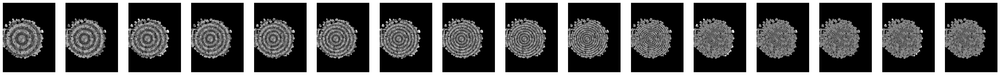

[[0.2107554325290777, 0.1727866944983458, 0.10350563802566659], [0.22110041051942922, 0.17380879542155037, 0.10766139596212877], [0.21914261830134316, 0.16839800286205506, 0.10996017124986046], [0.22186401741177786, 0.17188731000792012, 0.11133555079217569], [0.21894819416554442, 0.1719942560235324, 0.10891654024744621], [0.2217806055028663, 0.1724164748761432, 0.10700037069949886], [0.22141899878846708, 0.16832429675121016, 0.10754033663472454], [0.21990625196685037, 0.16988124420318299, 0.10989068060733033], [0.22068622137517355, 0.1671496390989396, 0.11017545657066592], [0.22143604667055597, 0.1689445125840616, 0.11204220836515025], [0.22101238129095357, 0.1706721818813319, 0.11502352794567738], [0.22098621966241797, 0.1660464624117397, 0.11487574216119525], [0.22084815482219208, 0.17069383667575266, 0.1158100143354449], [0.22480873159951786, 0.1747430170896382, 0.11649589613031511], [0.2201489034062509, 0.1679492099580168, 0.11528374149706729], [0.22050040926234327, 0.1713141586144

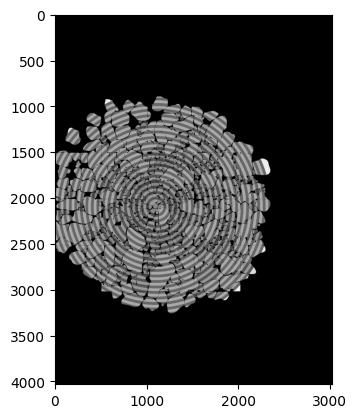

In [ ]:
# ring calibration for possible combination number of rings and ring diameter increase
import time

Rings=40

Image_total_masks=[]
SI=[]
#SI=[[] for o in range(1)for p in range(1) for r in range(Rings)]

for H in range(0,Hf):
  row=[]
  for W in range(0,Wf):
    row.append(image_Coke[H][W]+2*image_Sinter[H][W]+3*image_Pellet[H][W])
  Image_total_masks.append(row)

mask_binary=[]
for H in range(0,Hf):
  mask_binary.append(np.concatenate(Image_total_masks[H],axis=1))
plt.figure(figsize=(2*Wf, 2*Hf))
plt.axis('off')
Loc_image=np.concatenate(mask_binary)

xlim=len(Loc_image)
ylim=len(Loc_image[0])

# Diameters=[200,150,150,150,150,150,150]
# Origin=[1100,2100]

fig = plt.figure(figsize=(100, 20))
m=1
# Position
for o in range(2,3):#8
  for p in range(2,3):#8
    Origin=[1000+o*50,2000+p*50]#1000,2000
# Rings
    for r in range(0,Rings-1):#Rings-1):
# Radius
      for k in range(1,20):#20):
        # Diameters=[50+10*k,10*k,10*k,10*k,10*k,10*k,10*k,10*k,10*k,10*k]
        Diameters=[50+10*k]
        Diameters += (1+r)*[10*k]
        edge=sum(Diameters)
        Outeredge=edge*edge
        if edge <=1200 or edge >=1300:
          continue
        t = time.time()
        Loc_image=np.concatenate(mask_binary)
        Boundaries=[]

        for i in range(0,(3+r)):
          Boundaries.append((sum(Diameters[:i]))**2)
        print(o,p,r+1,k)
        cokesum=[0]*(2+r)
        sintersum=[0]*(2+r)
        pelletsum=[0]*(2+r)
        Pixels=[0]*(2+r)
# Pixels in image
        for y in range(xlim):
          for x in range(ylim):
# Check if in range of outer otherwise pass all checks
            if (x-Origin[0])*(x-Origin[0]) +(y-Origin[1])*(y-Origin[1]) > Outeredge:
              if Loc_image[y][x]==0:
                Loc_image[y][x]+=15
              continue
# Check in which ring it falls
            for i in range(0,(2+r)):
              if (x-Origin[0])*(x-Origin[0]) +(y-Origin[1])*(y-Origin[1]) < Boundaries[i+1] and (x-Origin[0])*(x-Origin[0]) +(y-Origin[1])*(y-Origin[1]) >= Boundaries[i]:
                if Loc_image[y][x]==1:
                  cokesum[i]+=1
                elif Loc_image[y][x]==2:
                  sintersum[i]+=1
                elif Loc_image[y][x]==3:
                  pelletsum[i]+=1
                Pixels[i]+=1
                if (i % 2) ==0:
                  if Loc_image[y][x]==0:
                    Loc_image[y][x]+=15
                  else:
                    Loc_image[y][x]+=4
                else:
                  if Loc_image[y][x]==0:
                    Loc_image[y][x]+=15
                  else:
                    Loc_image[y][x]+=8

                break
          # if Loc_image[y][x]==0:
          #   Loc_image[y][x]=Loc_image[y][x]+15

# Counts to concentration
        C_coke=np.divide(cokesum,Pixels)
        C_Sinter=np.divide(sintersum,Pixels)
        C_Pellet=np.divide(pelletsum,Pixels)
# Average concentrations
        TCokeAvg = (sum(C_coke)) /(2+r)
        TSinterAvg = (sum(C_Sinter)) /(2+r)
        TPelletAvg = (sum(C_Pellet)) /(2+r)

        dif_TC=[]
        dif_TS=[]
        dif_TP=[]

        for i in range(0,(2+r)):
          dif_TC.append((C_coke[i]-TCokeAvg)*(C_coke[i]-TCokeAvg))
          dif_TS.append((C_Sinter[i]-TSinterAvg)*(C_Sinter[i]-TSinterAvg))
          dif_TP.append((C_Pellet[i]-TPelletAvg)*(C_Pellet[i]-TPelletAvg))

        SI.append([math.sqrt(sum(dif_TC)/((2+r)-1)),math.sqrt(sum(dif_TS)/((2+r)-1)),math.sqrt(sum(dif_TP)/((2+r)-1))])#SI[3*(4*o+p)+r]
        print(time.time()-t)
        fig.add_subplot(1, 35, m)
        plt.axis('off')
        plt.imshow(Loc_image,cmap='gray_r')
        m+=1
plt.show()

print(SI)
plt.imshow(Loc_image,cmap='gray_r')


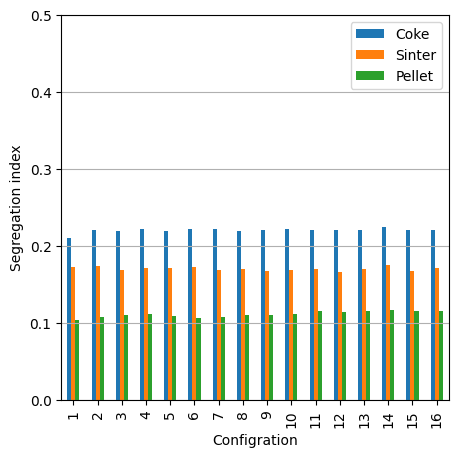

In [ ]:
# Plot of the SI from the ring calibration
Si_coke=[]
Si_sinter=[]
Si_pellet=[]
#Index=[]
for i in range(0,len(SI)):
  #for j in range(0,len(SI[i])-4):
    Si_coke.append(SI[i][0])
    Si_sinter.append(SI[i][1])
    Si_pellet.append(SI[i][2])
  #Index.append(i+1)

plotdata = pd.DataFrame({

    "Coke":Si_coke,

    "Sinter":Si_sinter,

    "Pellet":Si_pellet
    },

    index=range(1,len(Si_coke)+1))

plotdata.plot(kind="bar",figsize=(5, 5))
plt.xlabel("Configration")
plt.ylabel("Segregation index")
plt.ylim([0,0.5])
plt.grid(axis='y')

In [ ]:
print(max(Si_coke[:24]))
print(Si_coke.index(max(Si_coke[:24])))

0.22480873159951786
13


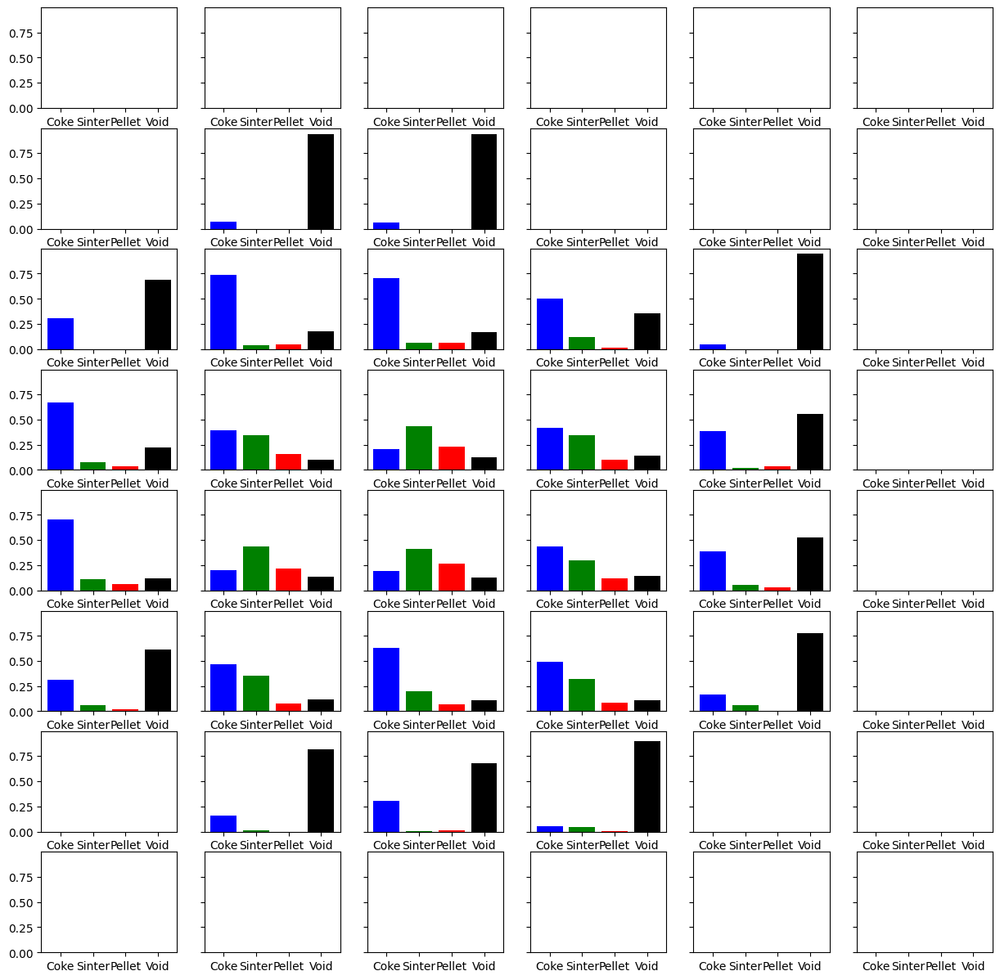

In [ ]:
fig, axs = plt.subplots(Hf, Wf,figsize=(15, 15), sharey=True)

for i in range(0,Hf):
  for j in range(0,Wf):
    axs[i,j].bar(["Coke","Sinter","Pellet","Void"],Tot_ratios[i*Wf+j],color=["blue","green","red","black"])

In [ ]:
import seaborn as sns

#create histogram with density curve overlaid
#sns.displot(data, kde=True, bins=15)

Coke_feret=[]
Coke_EL=[]
Sinter_feret=[]
Sinter_EL=[]
Pellet_feret=[]
Pellet_EL=[]
for i in range(0,len(Output_feret_Coke)):
  for j in range(0,len(Output_feret_Coke[i])):
    Coke_feret.append(Output_feret_Coke[i][j][0])
    Coke_EL.append(Output_feret_Coke[i][j][0] / Output_feret_Coke[i][j][1])
  for j in range(0,len(Output_feret_Sinter[i])):
    Sinter_feret.append(Output_feret_Sinter[i][j][0])
    Sinter_EL.append(Output_feret_Sinter[i][j][0] / Output_feret_Sinter[i][j][1])
  for j in range(0,len(Output_feret_Pellet[i])):
    Pellet_feret.append(Output_feret_Pellet[i][j][0])
    Pellet_EL.append(Output_feret_Pellet[i][j][0] / Output_feret_Pellet[i][j][1])


In [ ]:
# Preparing the data for the distribution plots
Data=[]
for i in range(0,len(Num_par)):
  #Data.append([0,0,0,"Sinter",i]) # un comment to line up sections with image
  for j in range(0,len(Output_feret_Coke[i])):
    Data.append([Output_feret_Coke[i][j][0],Output_feret_Coke[i][j][1] / Output_feret_Coke[i][j][0],2*math.sqrt(Output_Area_Coke[i][j]/math.pi),"Coke",i])
  for k in range(0,len(Output_feret_Sinter[i])):
    Data.append([Output_feret_Sinter[i][k][0],Output_feret_Sinter[i][k][1] / Output_feret_Sinter[i][k][0],2*math.sqrt(Output_Area_Sinter[i][k]/math.pi),"Sinter",i])
  for l in range(0,len(Output_feret_Pellet[i])):
    Data.append([Output_feret_Pellet[i][l][0],Output_feret_Pellet[i][l][1] / Output_feret_Pellet[i][l][0],2*math.sqrt(Output_Area_Pellet[i][l]/math.pi),"Pellet",i])
D=pd.DataFrame(Data, columns=["Max_Feret_Diameter","Flat_and_elongation_ratio","Area_eq_Diameter","Material","Section"])

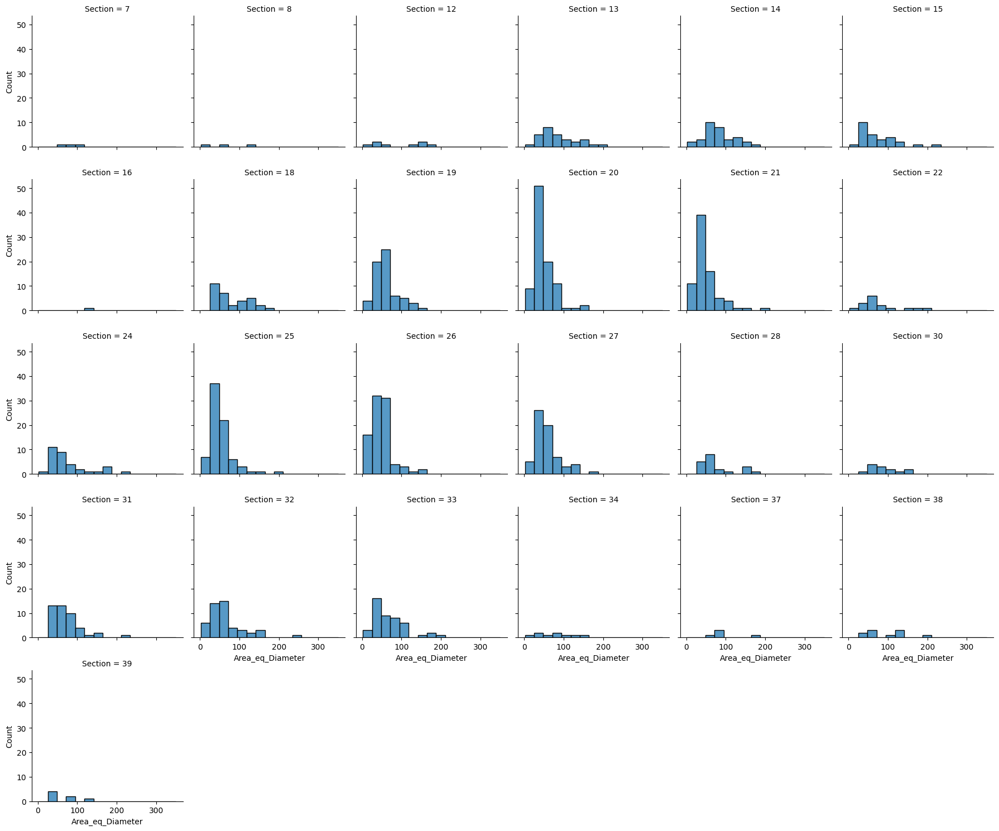

In [ ]:
# distribution plots per section in image
g = sns.FacetGrid(data=D, col='Section' , col_wrap=6)
#ax = sns.distplot(data1, kde=True, hist=True, hist_kws={"range": [0,10]})
#ax.set_xlim(0, 10)
#g.map(sns.histplot, 'Max_Feret_Diameter',kde=False,binrange=[2,350],bins=15)
g.map(sns.histplot, 'Area_eq_Diameter',kde=False,binrange=[2,350],bins=15)
#g.set_xlim(2, 350)

Text(17.95956944444444, 0.5, 'Proportion')

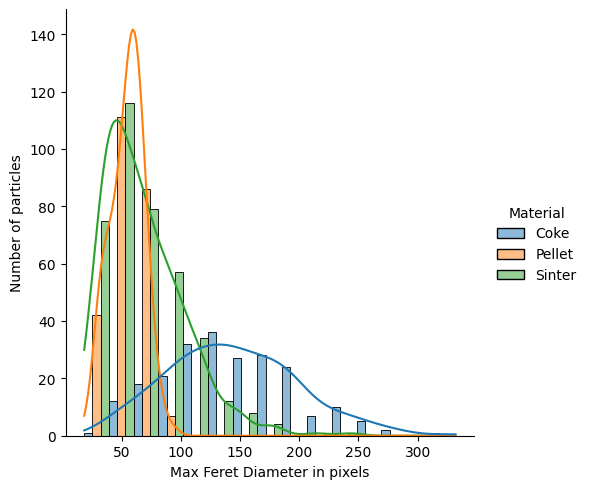

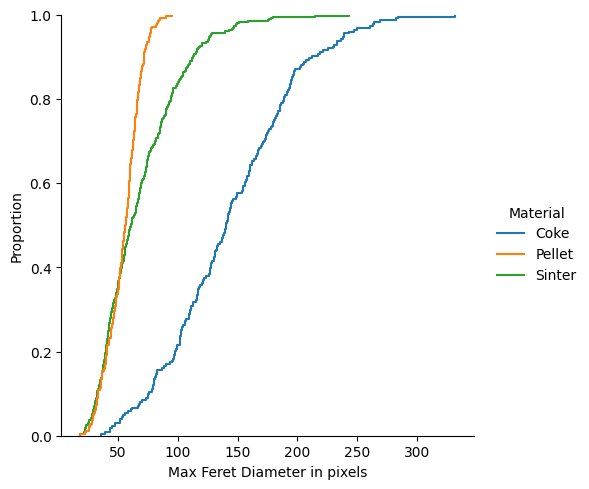

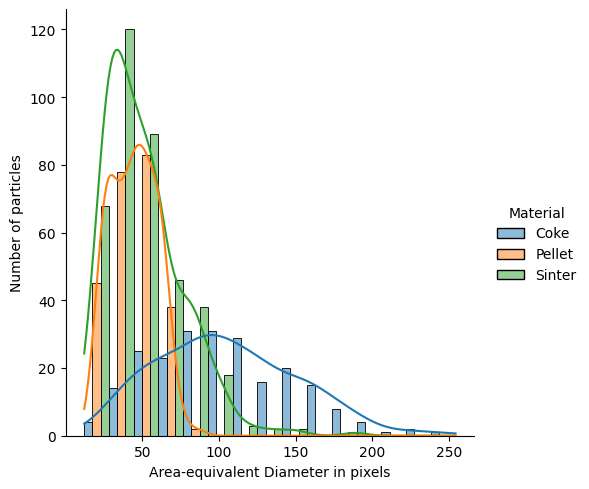

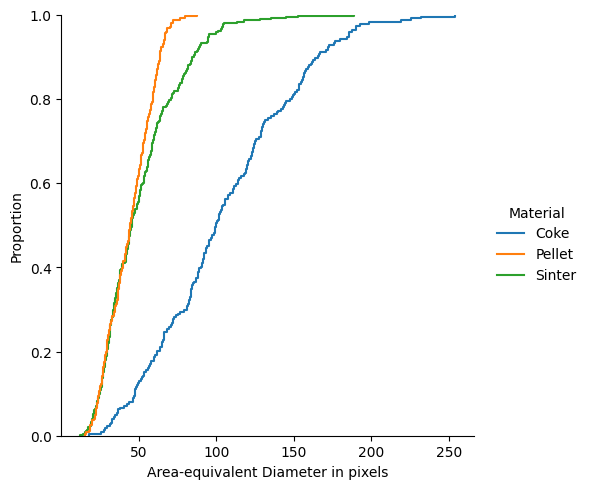

In [ ]:
# Distribution plots and ECDF plots
sns.displot(D,x="Max_Feret_Diameter",hue="Material",multiple="dodge",kde=True,bins=15)
plt.xlabel("Max Feret Diameter in pixels")
plt.ylabel("Number of particles")
sns.displot(D,x="Max_Feret_Diameter",hue="Material",kind="ecdf")
plt.xlabel("Max Feret Diameter in pixels")
plt.ylabel("Proportion")
sns.displot(D,x="Area_eq_Diameter",hue="Material",multiple="dodge",kde=True,bins=15)
plt.xlabel("Area-equivalent Diameter in pixels")
plt.ylabel("Number of particles")
sns.displot(D,x="Area_eq_Diameter",hue="Material",kind="ecdf")
plt.xlabel("Area-equivalent Diameter in pixels")
plt.ylabel("Proportion")


Text(5.069444444444445, 0.5, 'Number of particles')

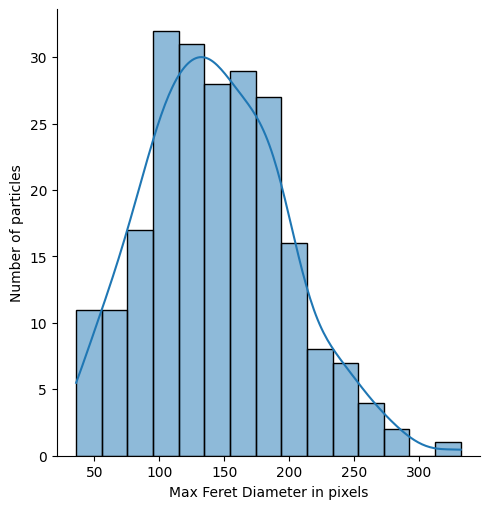

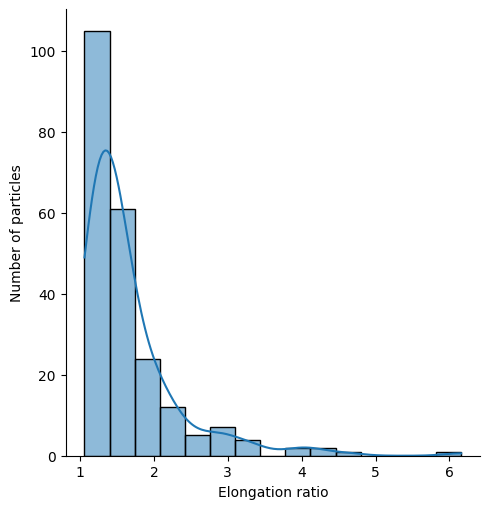

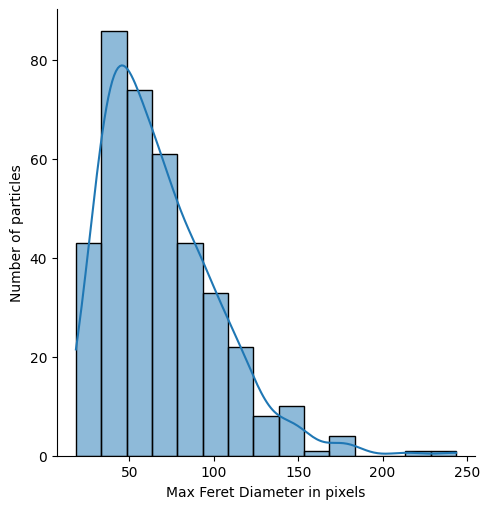

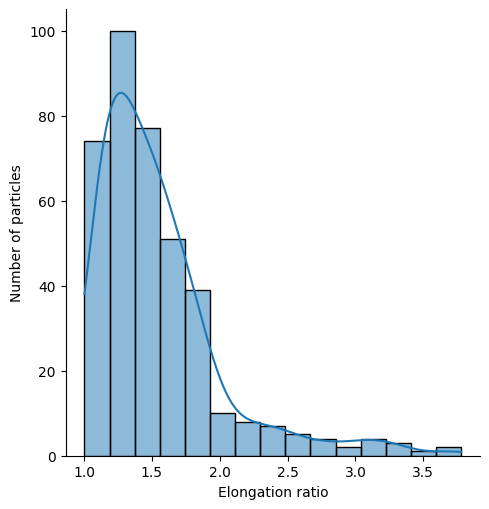

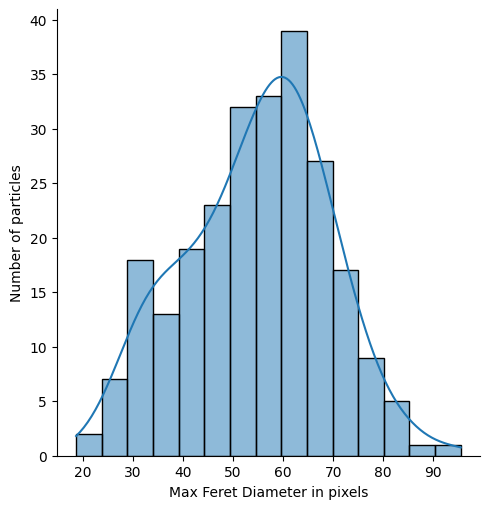

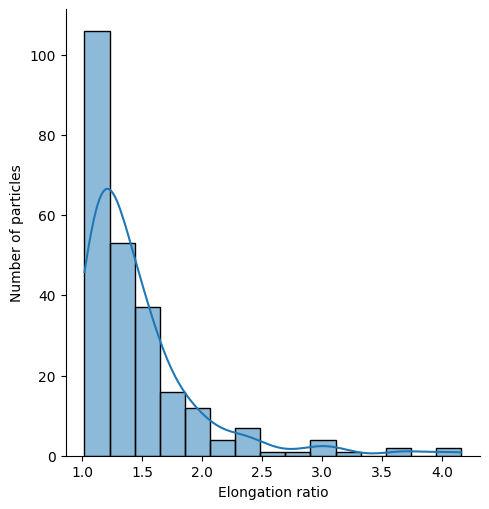

In [ ]:
# More distribution plots
sns.displot(Coke_feret,kde=True, bins=15)
plt.xlabel("Max Feret Diameter in pixels")
plt.ylabel("Number of particles")
sns.displot(Coke_EL, kde=True, bins=15)
plt.xlabel("Elongation ratio")
plt.ylabel("Number of particles")
sns.displot(Sinter_feret, kde=True, bins=15)
plt.xlabel("Max Feret Diameter in pixels")
plt.ylabel("Number of particles")
sns.displot(Sinter_EL, kde=True, bins=15)
plt.xlabel("Elongation ratio")
plt.ylabel("Number of particles")
sns.displot(Pellet_feret, kde=True, bins=15)
plt.xlabel("Max Feret Diameter in pixels")
plt.ylabel("Number of particles")
sns.displot(Pellet_EL, kde=True, bins=15)
plt.xlabel("Elongation ratio")
plt.ylabel("Number of particles")


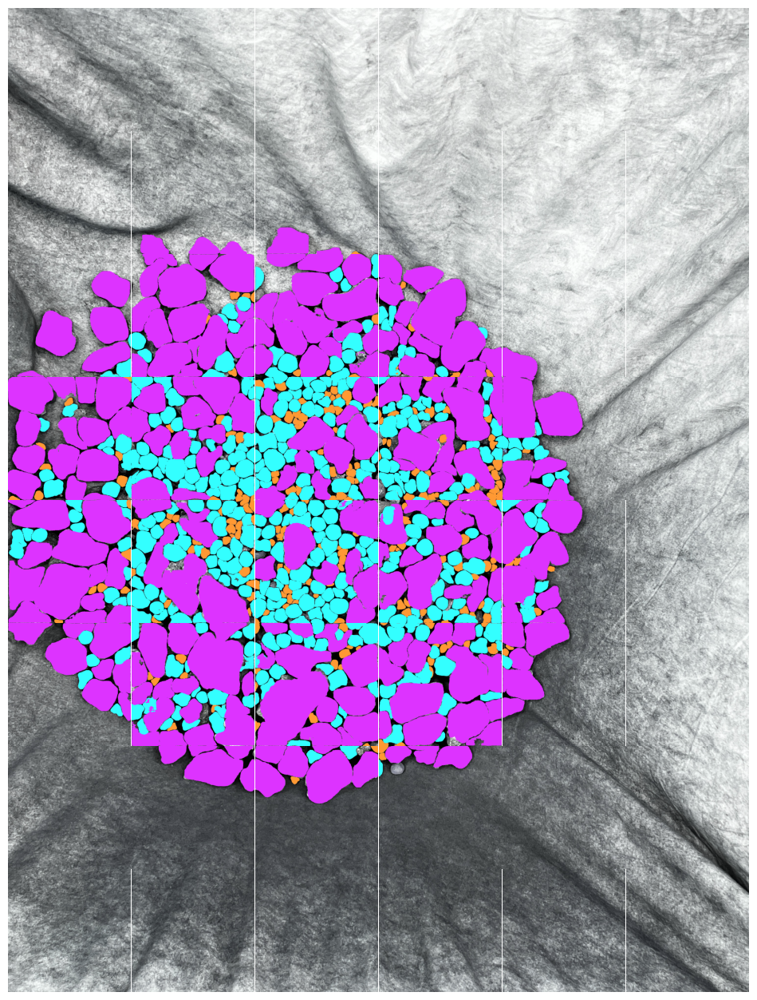

In [ ]:
# Creates image for the particle size classes Ferret diameter
PSIZE_IM = cv2.imread("/content/drive/MyDrive/Thesis/IMG_4923.JPG")
PSsliced = np.split(PSIZE_IM,Hf,axis=0)
PSSections =  [np.split(img_slice,Wf,axis=1) for img_slice in PSsliced]
Ph=504
Pw=504
for H in range(0,Hf):
  for W in range(0,Wf):
    if len(Output_Tiny_F[H*Wf+W])!=0:
      for i in range(0,Ph):
        for j in range(0,Pw):
          if Output_Tiny_F[H*Wf+W][i][j] == True:
            PSSections[H][W][i][j]=[255,153,51]
    if len(Output_Mid_F[H*Wf+W])!=0:
      for i in range(0,Ph):
        for j in range(0,Pw):
          if Output_Mid_F[H*Wf+W][i][j] == True:
            PSSections[H][W][i][j]=[51,255,255]
    if len(Output_Big_F[H*Wf+W])!=0:
      for i in range(0,Ph):
        for j in range(0,Pw):
          if Output_Big_F[H*Wf+W][i][j] == True:
            PSSections[H][W][i][j]=[221,51,255]

fig = plt.figure(figsize=(2*Wf, 2*Hf))
columns = Wf
rows = Hf
for H in range(0,Hf):
  for W in range(0,Wf):
    fig.add_subplot(rows, columns, H*Wf+W+1)
    plt.axis('off')
    plt.imshow(PSSections[H][W],aspect='equal')
fig.subplots_adjust(wspace=0, hspace=0)
plt.show()

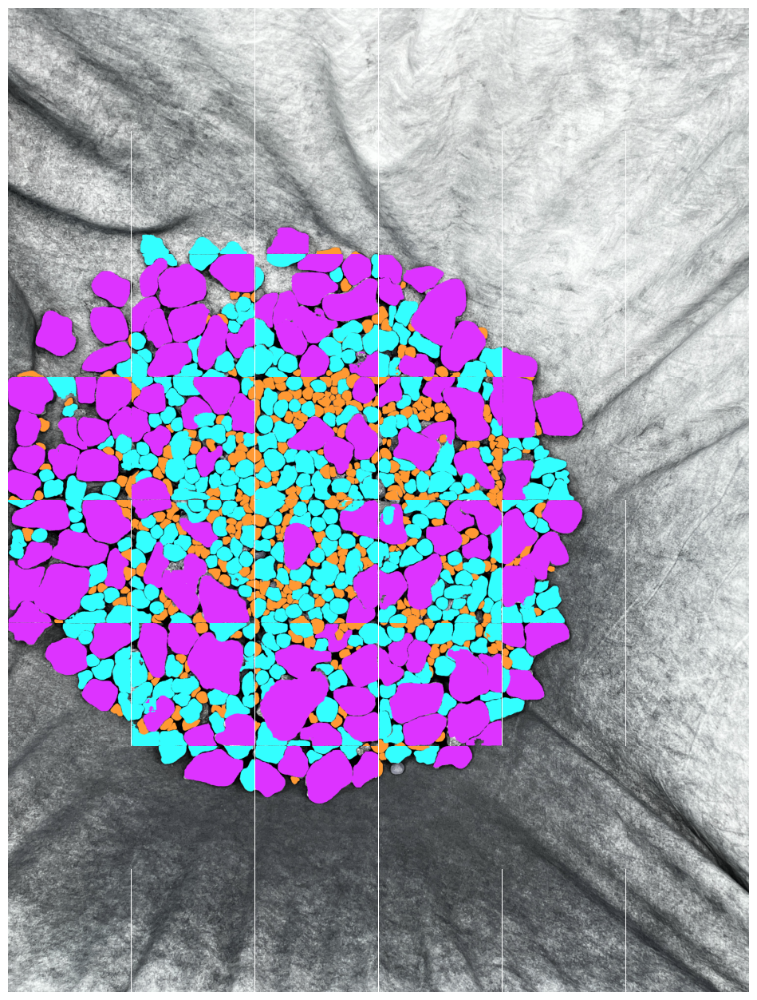

In [ ]:
# Creates image for the particle size classes area equivalent diameter
PSIZE_IM = cv2.imread("/content/drive/MyDrive/Thesis/IMG_4923.JPG")
PSsliced = np.split(PSIZE_IM,Hf,axis=0)
PSSections =  [np.split(img_slice,Wf,axis=1) for img_slice in PSsliced]
Ph=504
Pw=504
for H in range(0,Hf):
  for W in range(0,Wf):
    if len(Output_Tiny_AE[H*Wf+W])!=0:
      for i in range(0,Ph):
        for j in range(0,Pw):
          if Output_Tiny_AE[H*Wf+W][i][j] == True:
            PSSections[H][W][i][j]=[255,153,51]
    if len(Output_Mid_AE[H*Wf+W])!=0:
      for i in range(0,Ph):
        for j in range(0,Pw):
          if Output_Mid_AE[H*Wf+W][i][j] == True:
            PSSections[H][W][i][j]=[51,255,255]
    if len(Output_Big_AE[H*Wf+W])!=0:
      for i in range(0,Ph):
        for j in range(0,Pw):
          if Output_Big_AE[H*Wf+W][i][j] == True:
            PSSections[H][W][i][j]=[221,51,255]

fig = plt.figure(figsize=(2*Wf, 2*Hf))
columns = Wf
rows = Hf
for H in range(0,Hf):
  for W in range(0,Wf):
    fig.add_subplot(rows, columns, H*Wf+W+1)
    plt.axis('off')
    plt.imshow(PSSections[H][W],aspect='equal')
fig.subplots_adjust(wspace=0, hspace=0)
plt.show()

In [ ]:
# segregation index based on the particle sizes. Both methods
Pixels = 504*504
Tot_Size_ratios = []
for i in range(0,Wf*Hf):
  tf=sum(Output_Tiny_F[i])
  mf=sum(Output_Mid_F[i])
  bf=sum(Output_Big_F[i])
  tea=sum(Output_Tiny_AE[i])
  mea=sum(Output_Mid_AE[i])
  bea=sum(Output_Big_AE[i])

  if type(tf)!=int:
    tf=sum(tf)
  if type(mf)!=int:
    mf=sum(mf)
  if type(bf)!=int:
    bf=sum(bf)
  if type(tea)!=int:
    tea=sum(tea)
  if type(mea)!=int:
    mea=sum(mea)
  if type(bea)!=int:
    bea=sum(bea)
  R_tf=0
  R_mf=0
  R_bf=0
  R_vf=0
  R_tea=0
  R_mea=0
  R_bea=0
  R_vea=0
  if tf!=0:
    R_tf = round(float(tf/Pixels),4)
  if mf!=0:
    R_mf = round(float(mf/Pixels),4)
  if bf!=0:
    R_bf = round(float(bf/Pixels),4)
  if (tf+mf+bf)!=0:
    R_vf = round(1-float((tf+mf+bf)/Pixels),4)
  if tea!=0:
    R_tea = round(float(tea/Pixels),4)
  if mea!=0:
    R_mea = round(float(mea/Pixels),4)
  if bea!=0:
    R_bea = round(float(bea/Pixels),4)
  if (tea+mea+bea)!=0:
    R_vea = round(1-float((tea+mea+bea)/Pixels),4)
  R=[R_tf , R_mf , R_bf , R_vf, R_tea , R_mea , R_bea , R_vea]
  Tot_Size_ratios.append(R)

M=0
Avg_tf=[]
Avg_mf=[]
Avg_bf=[]
Avg_tea=[]
Avg_mea=[]
Avg_bea=[]

I=[]
dif_tf=[]
dif_mf=[]
dif_bf=[]
dif_tea=[]
dif_mea=[]
dif_bea=[]

for i in range(0,len(Num_par)):
  if sum(Output_Num_Size[i])!=0:
    M=M+1
    if Output_Num_Size[i][0]!=0:
      Avg_tf.append(Tot_Size_ratios[i][0])
    if Output_Num_Size[i][1]!=0:
      Avg_mf.append(Tot_Size_ratios[i][1])
    if Output_Num_Size[i][2]!=0:
      Avg_bf.append(Tot_Size_ratios[i][2])
    if Output_Num_Size[i][3]!=0:
      Avg_tea.append(Tot_Size_ratios[i][4])
    if Output_Num_Size[i][4]!=0:
      Avg_mea.append(Tot_Size_ratios[i][5])
    if Output_Num_Size[i][5]!=0:
      Avg_bea.append(Tot_Size_ratios[i][6])

S_avg=sum(Avg_tf)/M , sum(Avg_mf)/M , sum(Avg_bf)/M , sum(Avg_tea)/M , sum(Avg_mea)/M , sum(Avg_bea)/M



I.append(math.sqrt(sum((Avg_tf[i]-S_avg[0])**2 for i in range(0,len(Avg_tf)))/(M-1)))
I.append(math.sqrt(sum((Avg_mf[i]-S_avg[1])**2 for i in range(0,len(Avg_mf)))/(M-1)))
I.append(math.sqrt(sum((Avg_bf[i]-S_avg[2])**2 for i in range(0,len(Avg_bf)))/(M-1)))
I.append(math.sqrt(sum((Avg_tea[i]-S_avg[3])**2 for i in range(0,len(Avg_tea)))/(M-1)))
I.append(math.sqrt(sum((Avg_mea[i]-S_avg[4])**2 for i in range(0,len(Avg_mea)))/(M-1)))
I.append(math.sqrt(sum((Avg_bea[i]-S_avg[5])**2 for i in range(0,len(Avg_bea)))/(M-1)))

print(I)

[0.02690547224388873, 0.13793349983717998, 0.2232800123163737, 0.06599750554377036, 0.13287778006373627, 0.17754860174235862]


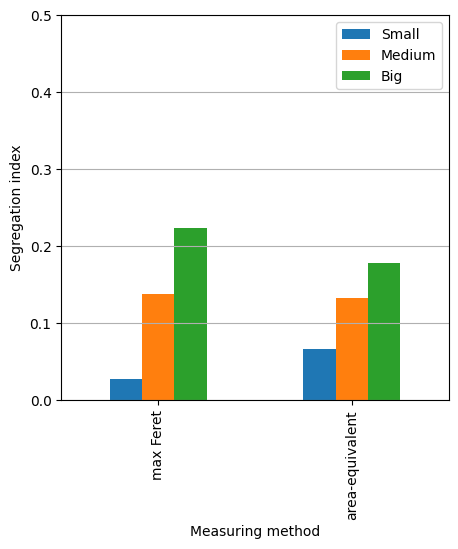

In [ ]:
# plot of SI
plotdata = pd.DataFrame({

    "Small":[I[0],I[3]],

    "Medium":[I[1],I[4]],

    "Big":[I[2],I[5]]},

    index=["max Feret", "area-equivalent"])

plotdata.plot(kind="bar",figsize=(5, 5))
plt.xlabel("Measuring method")
plt.ylabel("Segregation index")
plt.ylim([0,0.5])
plt.grid(axis='y')

In [ ]:
#Amount of particles small medium large first feret than area equivalent
Size_numbers=[0,0,0,0,0,0]
for i in range(0,len(Output_Num_Size)):
  for j in range(0,len(Size_numbers)):
    Size_numbers[j]=Size_numbers[j]+Output_Num_Size[i][j]

print(Size_numbers)

[227, 391, 240, 395, 334, 128]
